# The sim of a U-235 rod
The following code shows a 1d Model of a rod of U-235 and finds the critical length



In [3]:
import numpy as np
import random

def monte_carlo_critical_length_1d(a, b, num_simulations=10000, num_initial_fissions=100):
    L = 0.1  # start from L=0.1m
    while True:
        num_fissions = 0
        for _ in range(num_simulations):
            for _ in range(num_initial_fissions):
                initial_position = L * random.random()  # 1D position
                for _ in range(2):  # two secondary neutrons
                    direction = 1 if random.random() > 0.5 else -1
                    final_position = initial_position + direction * np.sqrt(2*a*b)
                    if 0 <= final_position <= L:
                        num_fissions += 1
        if num_fissions / (num_simulations * num_initial_fissions) >= 1:
            return L
        L += 0.001  # increase L by 0.1m

# Example usage:
a = 0.017  # mean free path for bouncing off
b = 0.21  # mean free path for causing fission
L_critical = monte_carlo_critical_length_1d(a, b)
print(f"The critical length of the rod is {L_critical}m")

The critical length of the rod is 0.17000000000000007m


# The slightly better model of the U-235 rod 
The following code Uses the neutrons function to add some randomness into the number of neutrons produced per fission reaction

In [72]:
import numpy as np
import random
from math import sqrt, pi, exp

def neutrons():
    """Number of secondary neutrons produced in each fission.

    Returns an integer number of neutrons, with average 2.5."""
    i=int(np.random.normal()+3.0)
    if (i<0): return 0
    else: return i

import numpy as np
import random

def monte_carlo_critical_length_1d(a, b, num_simulations=10000, num_initial_fissions=500):
    L = 0.1  # start from L=0.1m
    while True:
        num_fissions = 0
        for _ in range(num_simulations):
            for _ in range(num_initial_fissions):
                initial_position = L * random.random()  # 1D position
                for _ in range(neutrons()):  # secondary neutrons
                    direction = 1 if random.random() > 0.5 else -1
                    final_position = initial_position + direction * np.sqrt(2*a*b)
                    if 0 <= final_position <= L:
                        num_fissions += 1
        if num_fissions / (num_simulations * num_initial_fissions) >= 1:
            return L
        L += 0.01  # increase L by 0.1m

# Example usage:
a = 0.017  # mean free path for bouncing off
b = 0.21  # mean free path for causing fission
L_critical = monte_carlo_critical_length_1d(a, b)
print(f"The critical length of the rod is {L_critical}m")


The critical length of the rod is 0.15000000000000002m


# The 3D model
The following model uses a 3d cube of side length L in order to model the U-235 fission reaction with the reaction of the particles causing the fission neutrons to travel in angles set by spherical co-ordinates parameters

In [103]:
# Import necessary libraries
import numpy as np
import random
from math import acos, sin, cos, pi, sqrt, log

# Define a function to calculate the number of secondary neutrons produced in each fission
def neutrons():
    """Number of secondary neutrons produced in each fission.
    
    Returns an integer number of neutrons, with average 2.5."""
    i=int(np.random.normal()+3.0)
    if (i<0): return 0
    else: return i

# Define a function to calculate the distance diffused by a neutron before causing fission
def diffusion():
    """Distance diffused by a neutron before causing fission.
    
    Returns a random number with probability density p(s) =
    s^2 exp(-3s^2/R^2). This distribution has a mean of 1, so
    multiply by R to get the physical distance."""
    a=cos(2.0*pi*np.random.random())
    return sqrt(-0.667*(log(random.random())+log(random.random())*a*a))

# Define a function to calculate the critical length of a cube in 3D
def monte_carlo_critical_length_3d(a, b, num_simulations=10000, num_initial_fissions=100):
    L = 0.1  # start from L=0.1m
    step_size = 0.001  # decrease the step size
    while True:
        num_fissions = 0
        for _ in range(num_simulations):
            for _ in range(num_initial_fissions):
                initial_position = np.array([L * random.random() for _ in range(3)])  # 3D position
                for _ in range(neutrons()):  # secondary neutrons
                    phi = 2.0 * pi * random.random()
                    theta = acos(2.0 * random.random() - 1.0)
                    s = np.sqrt(2*a*b) * diffusion()
                    final_position = initial_position + s * np.array([sin(theta) * cos(phi), sin(theta) * sin(phi), cos(theta)])
                    if all(0 <= coord <= L for coord in final_position):
                        num_fissions += 1
        if num_fissions / (num_simulations * num_initial_fissions) >= 1:
            return L
        L += step_size  # increase L by the step size

# Example usage:
a = 0.017  # mean free path for bouncing off
b = 0.21  # mean free path for causing fission

# Calculate the average critical length of the cube
L_critical_values = []
for i in range(10):
    L_critical_values.append(monte_carlo_critical_length_3d(a, b, num_simulations=1, num_initial_fissions=100))
print(f"The average critical length of the cube is {np.mean(L_critical_values)}m")

# Calculate the critical mass of the cube
volume = np.mean(L_critical_values)**3
density = 18.7e3
mass = volume * density
print(f"The critical mass of the cube is {mass}kg")



The average critical length of the cube is 0.13390000000000005m
The critical mass of the cube is 44.89348679530004kg


# The Model Of the 3D model
The following code animates the monte-carlo simulation in the cube so you can see glimpses of the reaction and can see how the neutrons move about in the cube and also trying to look like the animation on the blackboard for the notes


MovieWriter imagemagick unavailable; using Pillow instead.


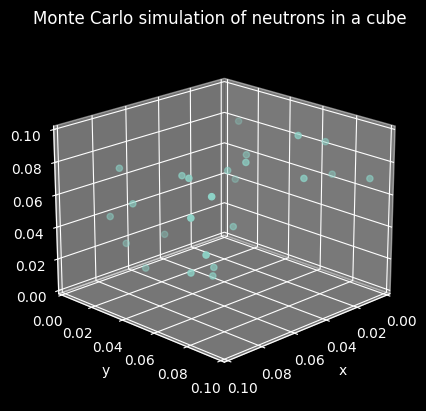

In [107]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from mpl_toolkits.mplot3d import Axes3D
a=0.017
b=0.21
L=0.1
def monte_carlo_step(L, a, b, num_neutrons=100):
    positions = []
    for _ in range(num_neutrons):
        # Initial position within the cube
        initial_position = np.array([L * random.random() for _ in range(3)])  
        # Random direction
        phi = 2.0 * pi * random.random()
        theta = acos(2.0 * random.random() - 1.0)
        # Limit the step size to stay within the cube
        s = min(np.sqrt(2*a*b) * diffusion(), L)
        # New position
        final_position = initial_position + s * np.array([sin(theta) * cos(phi), sin(theta) * sin(phi), cos(theta)])
        # Check if the neutron stays within the cube
        if all(0 <= coord <= L for coord in final_position):
            positions.append(final_position)
    return zip(*positions)  # returns three lists: x, y, z


# Set up the figure and 3D axes
fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')

# Initialize the scatter plot for the animation
scat = ax.scatter([], [], [])

# Function to initialize the animation
def init():
    scat._offsets3d = ([], [], [])
    return scat,

# Function to update the animation for each frame
def update(frame):
    # Perform one step of the Monte Carlo simulation here
    # and get the new positions of the neutrons
    x, y, z = monte_carlo_step(L, a, b, num_neutrons=100)
    scat._offsets3d = (x, y, z)
    return scat,

# Define the number of frames
num_frames = 1000
ax.set_xlim([0, L])
ax.set_ylim([0, L])
ax.set_zlim([0, L])
plt.xlabel('x')
plt.ylabel('y')
ax.set_zlabel('z')
ax.set_title('Monte Carlo simulation of neutrons in a cube')
ax.view_init(elev=20, azim=45)
plt.style.use('dark_background')


# Create the animation
ani = animation.FuncAnimation(fig, update, frames=range(100), init_func=init, blit=True)

# Save the animation as a gif file
ani.save('U235ani.gif',writer='imagemagick')

# Display the animation in the Jupyter Notebook
from IPython.display import HTML
HTML(ani.to_jshtml())


# Paths
The following code is to be able to see the paths of the neutrons as they go undergo fission in the cube. Not particularly clear.

MovieWriter imagemagick unavailable; using Pillow instead.


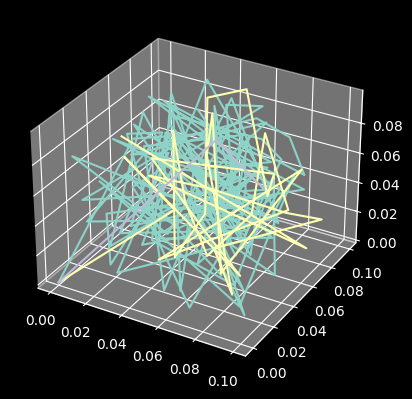

In [114]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from mpl_toolkits.mplot3d import Axes3D

# Set up the figure and 3D axes
fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')



# Function to initialize the animation
def init():
    return []

# Initialize the list of positions for 3 neutrons
positions = [[(0, 0, 0)] for _ in range(3)]  

# Function to update the animation for each frame
def update(frame):
    # Perform one step of the Monte Carlo simulation here
    # and get the new positions of the 3 neutrons
    new_positions = monte_carlo_step(L, a, b, num_neutrons=3)
    # Add the new positions to the list
    for pos, new_pos in zip(positions, new_positions):
        pos.append(new_pos)
    # Clear the previous lines
    ax.cla()
    # Plot the new lines
    for pos in positions:
        x, y, z = zip(*pos)
        ax.plot(x, y, z)
    return []

# Example usage:
def monte_carlo_step(L, a, b, num_neutrons=3):
    positions = []
    for _ in range(num_neutrons):
        # Initial position within the cube
        initial_position = np.array([L * random.random() for _ in range(3)])  
        # Random direction
        phi = 2.0 * pi * random.random()
        theta = acos(2.0 * random.random() - 1.0)
        # Limit the step size to stay within the cube
        s = min(np.sqrt(2*a*b) * diffusion(), L)
        # New position
        final_position = initial_position + s * np.array([sin(theta) * cos(phi), sin(theta) * sin(phi), cos(theta)])
        # Check if the neutron stays within the cube
        if all(0 <= coord <= L for coord in final_position):
            positions.append(final_position)
    return positions


# Create the animation
ani = animation.FuncAnimation(fig, update, frames=range(100), init_func=init, blit=True)

# Save the animation as a gif file
ani.save('U235ani.gif',writer='imagemagick')

# Display the animation in the Jupyter Notebook
from IPython.display import HTML
HTML(ani.to_jshtml())